# **Project Name**    -  Paisabazaar Banking Fraud Analysis



##### **Project Type**    - EDA
##### **Contribution**    - Individual (PAWAN AJAY PRASAD)


# **Project Summary -**

Paisabazaar is a financial services company that helps customers choose suitable banking and credit products. A crucial part of this process is evaluating customer credit worthiness. This project performs Exploratory Data Analysis (EDA) on customer financial and behavioral data to understand the factors influencing Credit Score classification (Good, Standard, Poor).

The analysis focuses on:

Understanding customer financial patterns

Identifying high-risk indicators

Studying the relationship between income, debt, utilization, and payment behavior

Generating business insights for risk segmentation

The insights derived from this EDA will help improve credit risk assessment, reduce default risk, and support data-driven decision-making.

# **GitHub Link -**

https://github.com/PAWAN0207

# **Problem Statement**


To analyze and understand which financial and behavioral features significantly influence a customer's credit score category and identify patterns associated with high credit risk.


#### **Define Your Business Objective?**

The primary business objective is to:

1) Identify key financial factors affecting credit score.

2) Segment customers into risk categories.

3) Detect high-risk customers early.

4) Support smarter loan approval decisions.

5) Reduce financial losses due to poor credit assessment.

# ***Let's Begin !***

## ***1. Know Your Data***

### Import Libraries

In [14]:
# Import Libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

In [15]:
import warnings
warnings.filterwarnings("ignore", category=FutureWarning)


### Dataset Loading

In [16]:
# Load Dataset
file_path = r"C:\Users\PAWAN PRASAD\Desktop\EDA ON PAISABAZAR_FRAUD_ANALYSIS_DATASET\dataset.csv"
dataset = pd.read_csv(file_path)

### Dataset First View

In [17]:
# Dataset First Look
dataset.head()

,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
0,5634,3392,1,Aaron Maashoh,23.0,821000265.0,Scientist,19114.12,1824.843333,3.0,...,Good,809.98,26.822620,265.0,No,49.574949,21.46538,High_spent_Small_value_payments,312.494089,Good
1,5635,3392,2,Aaron Maashoh,23.0,821000265.0,Scientist,19114.12,1824.843333,3.0,...,Good,809.98,31.944960,266.0,No,49.574949,21.46538,Low_spent_Large_value_payments,284.629162,Good
2,5636,3392,3,Aaron Maashoh,23.0,821000265.0,Scientist,19114.12,1824.843333,3.0,...,Good,809.98,28.609352,267.0,No,49.574949,21.46538,Low_spent_Medium_value_payments,331.209863,Good
3,5637,3392,4,Aaron Maashoh,23.0,821000265.0,Scientist,19114.12,1824.843333,3.0,...,Good,809.98,31.377862,268.0,No,49.574949,21.46538,Low_spent_Small_value_payments,223.451310,Good
4,5638,3392,5,Aaron Maashoh,23.0,821000265.0,Scientist,19114.12,1824.843333,3.0,...,Good,809.98,24.797347,269.0,No,49.574949,21.46538,High_spent_Medium_value_payments,341.489231,Good


### Dataset Rows & Columns count

In [18]:
# Dataset Rows & Columns count
rows, columns = dataset.shape
print("Number of rows:", rows)
print("Number of columns:", columns)

Number of rows: 100000
Number of columns: 28


### Dataset Information

In [19]:
# Dataset Info
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 28 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   ID                        100000 non-null  int64  
 1   Customer_ID               100000 non-null  int64  
 2   Month                     100000 non-null  int64  
 3   Name                      100000 non-null  object 
 4   Age                       100000 non-null  float64
 5   SSN                       100000 non-null  float64
 6   Occupation                100000 non-null  object 
 7   Annual_Income             100000 non-null  float64
 8   Monthly_Inhand_Salary     100000 non-null  float64
 9   Num_Bank_Accounts         100000 non-null  float64
 10  Num_Credit_Card           100000 non-null  float64
 11  Interest_Rate             100000 non-null  float64
 12  Num_of_Loan               100000 non-null  float64
 13  Type_of_Loan              100000 non-null  ob

#### Duplicate Values

In [20]:
# Dataset Duplicate Value Count
duplicate_count = dataset.duplicated().sum()
print("Number of duplicate rows:", duplicate_count)

Number of duplicate rows: 0


#### Missing Values/Null Values

In [21]:
# Missing Values/Null Values Count
missing_values = dataset.isnull().sum().sort_values(ascending = False).head(10)
print(missing_values)

ID                       0
Customer_ID              0
Month                    0
Name                     0
Age                      0
SSN                      0
Occupation               0
Annual_Income            0
Monthly_Inhand_Salary    0
Num_Bank_Accounts        0
dtype: int64


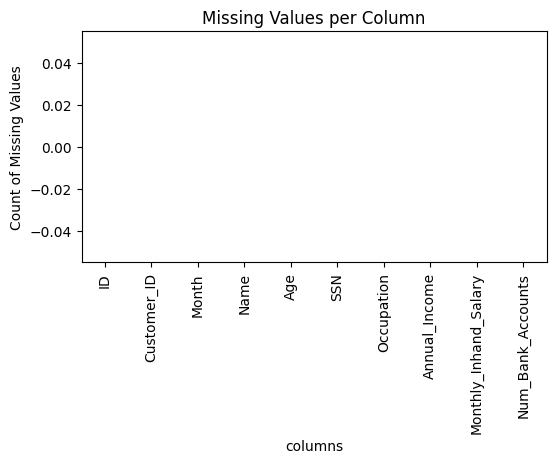

In [22]:
# Visualizing the missing values
plt.figure(figsize=(6,3))
sns.barplot(x=missing_values.index, y=missing_values.values, color="blue")
plt.xticks(rotation=90)
plt.title("Missing Values per Column")
plt.xlabel("columns")
plt.ylabel("Count of Missing Values")

plt.show()

### What did you know about your dataset?

The dataset had no missing values and no duplicates, which shows strong data quality.A few columns had formatting inconsistencies — for example, Credit History Age was not initially in a clean numeric format, and Payment Behaviour combined multiple pieces of information into one string. I observed that minimum payment behavior was nearly balanced across customers, spending behavior combined multiple financial signals in one feature, and many customers had multiple loan types, indicating potential loan burden impact on credit score.



## ***2. Understanding Your Variables***

In [23]:
# Dataset Columns
dataset.columns

Index(['ID', 'Customer_ID', 'Month', 'Name', 'Age', 'SSN', 'Occupation',
       'Annual_Income', 'Monthly_Inhand_Salary', 'Num_Bank_Accounts',
       'Num_Credit_Card', 'Interest_Rate', 'Num_of_Loan', 'Type_of_Loan',
       'Delay_from_due_date', 'Num_of_Delayed_Payment', 'Changed_Credit_Limit',
       'Num_Credit_Inquiries', 'Credit_Mix', 'Outstanding_Debt',
       'Credit_Utilization_Ratio', 'Credit_History_Age',
       'Payment_of_Min_Amount', 'Total_EMI_per_month',
       'Amount_invested_monthly', 'Payment_Behaviour', 'Monthly_Balance',
       'Credit_Score'],
      dtype='object')

In [24]:
# Dataset Describe
dataset.describe()

,ID,Customer_ID,Month,Age,SSN,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,...,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Total_EMI_per_month,Amount_invested_monthly,Monthly_Balance
count,100000.000000,100000.000000,100000.000000,100000.000000,1.000000e+05,100000.000000,100000.000000,100000.000000,100000.000000,100000.00000,...,100000.00000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000
mean,80631.500000,25982.666640,4.500000,33.316340,5.004617e+08,50505.123449,4197.270835,5.368820,5.533570,14.53208,...,21.08141,13.313120,10.470323,5.798250,1426.220376,32.285173,221.220460,107.699208,55.101315,392.697586
std,43301.486619,14340.543051,2.291299,10.764812,2.908267e+08,38299.422093,3186.432497,2.593314,2.067098,8.74133,...,14.80456,6.237166,6.609481,3.867826,1155.129026,5.116875,99.680716,132.267056,39.006932,201.652719
min,5634.000000,1006.000000,1.000000,14.000000,8.134900e+04,7005.930000,303.645417,0.000000,0.000000,1.00000,...,0.00000,0.000000,0.500000,0.000000,0.230000,20.000000,1.000000,0.000000,0.000000,0.007760
25%,43132.750000,13664.500000,2.750000,24.000000,2.451686e+08,19342.972500,1626.594167,3.000000,4.000000,7.00000,...,10.00000,9.000000,5.380000,3.000000,566.072500,28.052567,144.000000,29.268886,27.959111,267.615983
50%,80631.500000,25777.000000,4.500000,33.000000,5.006886e+08,36999.705000,3095.905000,5.000000,5.000000,13.00000,...,18.00000,14.000000,9.400000,5.000000,1166.155000,32.305784,219.000000,66.462304,45.156550,333.865366
75%,118130.250000,38385.000000,6.250000,42.000000,7.560027e+08,71683.470000,5957.715000,7.000000,7.000000,20.00000,...,28.00000,18.000000,14.850000,8.000000,1945.962500,36.496663,302.000000,147.392573,71.295797,463.215683
max,155629.000000,50999.000000,8.000000,56.000000,9.999934e+08,179987.280000,15204.633333,11.000000,11.000000,34.00000,...,62.00000,25.000000,29.980000,17.000000,4998.070000,50.000000,404.000000,1779.103254,434.191089,1183.930696


### Variables Description

Variables Description (Important Ones)

Annual_Income → Customer income level

Outstanding_Debt → Total unpaid debt

Num_of_Loan → Number of active loans

Delay_from_due_date → Days delayed in payment

Credit_Utilization_Ratio → % credit used

EMI_per_month → Monthly EMI burden

Credit_History_Age → Duration of credit history

Payment_Behaviour → Spending & repayment behavior

Credit_Score → Target variable

### Check Unique Values for each variable.

Check Unique Values for each variable.

In [25]:
# Categorical (Text) Columns
for col in dataset.select_dtypes(include='object').columns:
    print(f"Column Name: {col}")
    print(f"Unique Values: {dataset[col].unique()}")


Column Name: Name
Unique Values: ['Aaron Maashoh' 'Rick Rothackerj' 'Langep' ... 'Chris Wickhamm'
 'Sarah McBridec' 'Nicks']
Column Name: Occupation
Unique Values: ['Scientist' 'Teacher' 'Engineer' 'Entrepreneur' 'Developer' 'Lawyer'
 'Media_Manager' 'Doctor' 'Journalist' 'Manager' 'Accountant' 'Musician'
 'Mechanic' 'Writer' 'Architect']
Column Name: Type_of_Loan
Unique Values: ['Auto Loan, Credit-Builder Loan, Personal Loan, and Home Equity Loan'
 'Credit-Builder Loan' 'Auto Loan, Auto Loan, and Not Specified' ...
 'Home Equity Loan, Auto Loan, Auto Loan, and Auto Loan'
 'Payday Loan, Student Loan, Mortgage Loan, and Not Specified'
 'Personal Loan, Auto Loan, Mortgage Loan, Student Loan, and Student Loan']
Column Name: Credit_Mix
Unique Values: ['Good' 'Standard' 'Bad']
Column Name: Payment_of_Min_Amount
Unique Values: ['No' 'NM' 'Yes']
Column Name: Payment_Behaviour
Unique Values: ['High_spent_Small_value_payments' 'Low_spent_Large_value_payments'
 'Low_spent_Medium_value_payments' 

In [26]:
# Numerical (Numbers) Columns
for col in dataset.select_dtypes(include='number').columns:
    print(f"Column Name: {col}")
    print(f"Unique Values: {dataset[col].unique()}")

Column Name: ID
Unique Values: [  5634   5635   5636 ... 155627 155628 155629]
Column Name: Customer_ID
Unique Values: [ 3392  8625 11708 ... 44897 34304 37932]
Column Name: Month
Unique Values: [1 2 3 4 5 6 7 8]
Column Name: Age
Unique Values: [23. 28. 34. 54. 55. 21. 31. 33. 30. 24. 44. 45. 40. 41. 32. 35. 36. 39.
 37. 20. 46. 26. 42. 19. 48. 38. 43. 22. 16. 18. 15. 27. 25. 14. 17. 47.
 53. 56. 29. 49. 51. 50. 52.]
Column Name: SSN
Unique Values: [8.21000265e+08 4.07583900e+06 4.86853974e+08 ... 1.33167738e+08
 3.13509420e+07 7.87359900e+07]
Column Name: Annual_Income
Unique Values: [ 19114.12  34847.84 143162.64 ...  37188.1   20002.88  39628.99]
Column Name: Monthly_Inhand_Salary
Unique Values: [ 1824.84333333  3037.98666667 12187.22       ...  3097.00833333
  1929.90666667  3359.41583333]
Column Name: Num_Bank_Accounts
Unique Values: [ 3.  2.  1.  7.  4.  0.  8.  5.  6.  9. 10. 11.]
Column Name: Num_Credit_Card
Unique Values: [ 4.  5.  1.  7.  6.  8.  3.  9.  2. 10. 11.  0.]
Colum

## 3. ***Data Wrangling***

In [27]:
dataset.head()

,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
0,5634,3392,1,Aaron Maashoh,23.0,821000265.0,Scientist,19114.12,1824.843333,3.0,...,Good,809.98,26.822620,265.0,No,49.574949,21.46538,High_spent_Small_value_payments,312.494089,Good
1,5635,3392,2,Aaron Maashoh,23.0,821000265.0,Scientist,19114.12,1824.843333,3.0,...,Good,809.98,31.944960,266.0,No,49.574949,21.46538,Low_spent_Large_value_payments,284.629162,Good
2,5636,3392,3,Aaron Maashoh,23.0,821000265.0,Scientist,19114.12,1824.843333,3.0,...,Good,809.98,28.609352,267.0,No,49.574949,21.46538,Low_spent_Medium_value_payments,331.209863,Good
3,5637,3392,4,Aaron Maashoh,23.0,821000265.0,Scientist,19114.12,1824.843333,3.0,...,Good,809.98,31.377862,268.0,No,49.574949,21.46538,Low_spent_Small_value_payments,223.451310,Good
4,5638,3392,5,Aaron Maashoh,23.0,821000265.0,Scientist,19114.12,1824.843333,3.0,...,Good,809.98,24.797347,269.0,No,49.574949,21.46538,High_spent_Medium_value_payments,341.489231,Good


### Data Wrangling Code

In [28]:
# Create a copy of the current dataset and assigning to df
df = dataset.copy()

In [29]:
# Remove Irrelevant Columns
irrelevant_columns = ['ID', 'Name', 'SSN', 'Customer_ID']
df.drop(columns=irrelevant_columns, axis=1, inplace=True)

In [30]:
# Fix Payment_of_Min_Amount
# Column Name: Payment_of_Min_Amount
#  Unique Values: ['No' 'NM' 'Yes']
df['Payment_of_Min_Amount'] = df['Payment_of_Min_Amount'].replace('NM', 'No')

In [31]:
df['Payment_of_Min_Amount'] = df['Payment_of_Min_Amount'].fillna('No')

In [32]:
print(df['Payment_of_Min_Amount'].value_counts())

Payment_of_Min_Amount
Yes    52326
No     47674
Name: count, dtype: int64


In [33]:
# Type_of_Loan Column Cleaning
# 1) Replace junk labels with None
df['Type_of_Loan'] = df['Type_of_Loan'].replace(['No Data', 'Not Specified'], None)

In [34]:
# 2) Fill NaN with 'Unknown'
df['Type_of_Loan'] = df['Type_of_Loan'].fillna('Unknown')

In [35]:
# 3) Standardize separator
df['Type_of_Loan'] = df['Type_of_Loan'].str.replace(' and ', ',' , regex= False).str.strip()

In [36]:
# 4)  Split into list
df['Type_of_Loan'] = df['Type_of_Loan'].str.split(',')

In [37]:
# 5)  Clean each item inside the list

def clean_loans(x):
    if isinstance(x, list):
        cleaned = []
        for loan in x:
            loan = loan.strip()
            if loan != '' and loan != 'Not Specified':
                cleaned.append(loan)
        return list(set(cleaned))
    else:
        return []

df['Type_of_Loan'] = df['Type_of_Loan'].apply(clean_loans)

In [38]:
# Fill with median ( age/numeric columns)
df['Credit_History_Age'] = df['Credit_History_Age'].fillna(df['Credit_History_Age'].median())

In [39]:
# Fill with median (numeric columns)
df['Monthly_Balance'] = df['Monthly_Balance'].fillna(df['Monthly_Balance'].median())

In [40]:
# Removed the suffix _value_payments
# Low_spent_Small_value_payments
# ⬇
# Low_spent_Small
df['Payment_Behaviour'] = df['Payment_Behaviour'].str.replace('_value_payments', '')

In [41]:
# Split into two separate columns
# Spending_Level	       Payment_Size
#    Low	                   Small

df[['Spending_Level', 'Payment_Size']] = df['Payment_Behaviour'].str.split('_spent_', expand=True)

In [42]:
df.drop('Payment_Behaviour', axis=1, inplace=True)

### What all manipulations have you done and insights you found?

I started with cleaning the dataset to make it analysis-ready.
First, I removed columns like ID, Name, SSN, and Customer_ID because they don’t add analytical value and would just create noise.

Then I focused on cleaning categorical columns. For example, in the Payment_of_Min_Amount column, there were values like “NM”, so I standardized those to make the column logically consistent.

The Type_of_Loan column was a bit messy — it had inconsistent separators like “and” and commas, duplicate loan entries, and some missing labels. I standardized the format, removed unnecessary values, cleaned duplicates, and from that I also created a new feature called Loan_Count to understand loan burden per customer.

Another interesting part was the Payment_Behaviour column — it had combined information in a single string. So I split it into two meaningful features: Spending_Level and Payment_Size. That made the data much easier to analyze and interpret.

During EDA, I observed that customers with more delayed payments and higher outstanding debt generally had lower credit scores. Also, customers handling multiple loans showed slightly higher financial risk patterns.

## ***4. Data Vizualization, Storytelling & Experimenting with charts : Understand the relationships between variables***

## Univariate Analysis

#### Chart - 1  Credit Score Distribution

In [43]:
# Chart - 1 visualization code
fig = px.bar(df['Credit_Score'].value_counts().reset_index(name='count'),
             x='Credit_Score',
             y='count',
             title='Distribution of Credit Score Categories',
             labels={'Credit_Score': 'Credit Category', 'count': 'Number of Customers'},
             template='plotly_white')

fig.update_layout(
    title_x=0.5)

fig.show()


##### 1. Why did you pick the specific chart?

A bar chart is appropriate because Credit_Score is a categorical variable.
It allows clear comparison of the number of customers in each category (Standard, Poor, Good).

Bar charts make it easy to:

- Compare category frequencies visually

- Identify dominant segments

##### 2. What is/are the insight(s) found from the chart?

- The majority of customers fall under the Standard credit score category.

- A significant portion belongs to the Poor category.

- The Good credit score group is the smallest segment.

This suggests that most customers are average in terms of creditworthiness, while a noticeable percentage may represent financial risk (Poor category).

##### 3. Will the gained insights help creating a positive business impact?
Are there any insights that lead to negative growth? Justify with specific reason.

Positive Impact:

- Targeted Products: The company can focus on "Credit Builder" loans or specialized cards for the massive Standard/Poor segments to help them grow.

- Resource Allocation: Since most people are in the middle, the business can optimize its marketing for average-income products rather than high-end luxury services.

Negative Growth Risks:

- A relatively high proportion of customers in the Poor category could increase default risk.
If not managed properly, this may lead to higher bad debts and financial losses.

#### Chart - 2 Analysis of Annual Income Distribution

In [44]:
# Chart - 2 visualization code
fig = px.histogram(df,
                   x="Annual_Income",
                   marginal="box",
                   nbins=100,
                   title="Analysis of Annual Income Distribution",
                   labels={'Annual_Income': 'Annual Income (USD)'},
                   color_discrete_sequence=['#636EFA'],
                   template="plotly_white")


fig.update_layout(
    title_x=0.5,
    title_font_size=20,
    xaxis_title_font=dict(size=14),
    yaxis_title_font=dict(size=14),
    bargap=0.05)

fig.show()


##### 1. Why did you pick the specific chart?

I chose a Histogram with a Boxplot (marginal) because it provides a complete picture of the data.

The Histogram shows the "shape" of the income—where most people fall.

The Boxplot on top makes it very easy to spot Outliers (extreme high-earners) who might otherwise hide in a regular bar chart.

##### 2. What is/are the insight(s) found from the chart?

Income Clusters: The data has three main "peaks" around $20k, $40k, and $60k. This tells us our customers belong to three distinct economic groups.

The Long Tail: After $100k, the graph becomes very flat. This confirms that high-income earners are a small minority in this dataset.

Income Gap: There is a clear gap between the low-income earners and the elite, which means a "one-size-fits-all" loan product won't work.

##### 3. Will the gained insights help creating a positive business impact?
Are there any insights that lead to negative growth? Justify with specific reason.

Positive Business Impact

- Custom Products: The bank can design affordable "Micro-loans" specifically for the $20k-$40k income group to increase its customer base.

- Targeted Marketing: For the $60k+ group, the bank can offer premium credit cards with higher limits since they have more surplus cash.

Risk to Growth

- The Danger: If the bank gives too many loans to the $20k peak group without checking their debt-to-income ratio, it could lead to massive unpaid loans.

## Bivariate analysis

#### Chart - 3 Credit Score Analysis by Minimum Payment Behavior.

In [45]:
# Chart - 3 visualization code
fig = px.histogram(df,
                   x='Credit_Score',
                   color='Payment_of_Min_Amount',
                   barmode='group',
                   histnorm='percent',
                   title="Credit Score Split by Minimum Payment Behavior")

fig.update_layout(
    title_x=0.5,
    title_font_size=20)


fig.show()

##### 1. Why did you pick the specific chart?

A grouped bar chart is the best way to compare behavior across different categories.

It allows for a direct side-by-side comparison of "Yes" vs "No" responses within each credit score group.

By using percentages, it normalizes the data, making it easy to see the dominant behavior in "Good" vs "Poor" groups regardless of how many people are in each.

It clearly highlights the inverse relationship between paying minimum amounts and maintaining a high credit score

##### 2. What is/are the insight(s) found from the chart?

The "Good" Standard: Over 90% of people with a 'Good' credit score avoid paying just the minimum. They pay their bills in full.

The "Poor" Pattern: There is a massive correlation between paying only the minimum and having a 'Poor' score.

The Middle Trap: In the 'Standard' category, the "Yes" bar is higher than the "No" bar, suggesting many average earners are currently sliding toward debt.

##### 3. Will the gained insights help creating a positive business impact?
Are there any insights that lead to negative growth? Justify with specific reason.

Positive Business Impact

- Loyalty Perks: Knowing that "No" respondents in the "Good" category are low-risk, the company can offer them higher credit limits or lower interest rates to ensure they don't switch to competitors.

- The bank can spot 'Standard' customers who only pay the minimum amount each month.
By finding them early, the bank can offer help—like financial advice or easier payment plans—to stop them from falling into the 'Poor' category or failing to pay entirely.


Risk of Negative Growth

- The bank actually makes more money from interest when people only pay the minimum amount.However, the chart shows that these same people are the most likely to have a "Poor" credit score.

- If the bank relies too much on this interest, they face a big danger: these customers might stop paying altogether (default).
This causes a sudden loss of money, which hurts the bank's stability in the long run.

#### Chart - 4 Distribution of Outstanding Debt by Credit Score.


In [46]:
# Chart - 4 visualization code
fig = px.histogram(df,
                   x="Outstanding_Debt",
                   color="Credit_Score",
                   marginal="box",
                   barmode="overlay",
                   nbins=50,
                   opacity=0.7,
                   title="Debt Distribution Analysis by Credit Score")

fig.update_layout(
    title_x=0.5,
    title_font_size=20,
    bargap=0.1,
    xaxis_title_font=dict(size=14),
    yaxis_title_font=dict(size=14))

fig.show()


##### 1. Why did you pick the specific chart?

I chose a Stacked Histogram (color="Credit_Score") because looking at debt alone isn't enough.

It shows exactly how the volume of debt affects the quality of the credit score.

It reveals the specific "Debt Threshold" where a customer's score typically drops from Good to Poor.

It visualizes the total count of customers in each debt bracket, providing a clear view of the bank's overall risk exposure.

##### 2. What is/are the insight(s) found from the chart?

The "Hard Cutoff": Look at the $1,500 mark. Notice how the "Good" (blue) and "Standard" (orange) bars almost completely disappear after this point.

Dominance of High Debt in "Poor" Scores: Beyond $1,500, the chart is dominated by the "Poor" (green) category. High debt is a near-guarantee of a low credit score.

Low Debt Diversity: Below $1,500, we see a mix of all scores. This means having low debt doesn't guarantee a good score, but having high debt almost certainly guarantees a poor one.

##### 3. Will the gained insights help creating a positive business impact?
Are there any insights that lead to negative growth? Justify with specific reason.

 Positive Business Impact

- Automated Credit Caps: The bank can set a strict internal limit at $1,500. Anyone staying below this can be offered better rates to encourage healthy habits.

- Debt Consolidation Offers: For those in the $1,500 range, the bank can offer consolidation loans to help them clear debt before they hit the "danger zone."

Insights That Lead to Negative Growth

- Short-term Gain vs. Long-term Loss: High-debt customers pay more interest, which looks like profit today. However, the chart shows these customers are the most likely to have "Poor" credit scores.

- High Debt $\rightarrow$ Credit Score Crash ($>\$1,500$) $\rightarrow$ Default Risk $\uparrow \uparrow$

#### Chart - 5 Impact of Credit History Age on Credit Score.


In [47]:
# Chart - 5 visualization code
fig = px.box(df,
             x='Credit_Score',
             y='Credit_History_Age',
             color='Credit_Score',
             title='Credit History Age vs. Credit Score Analysis',
             labels={'Credit_Score': 'Credit Score',
                     'Credit_History_Age': ' Credit History Age (Years)'})



fig.update_layout(
    title_x=0.5,
    title_font_size=20,
    showlegend=False)

fig.show()


##### 1. Why did you pick the specific chart?


A boxplot is a good way to compare the distribution of Credit History Age across different Credit Score categories.


It helps identify differences between Good, Standard, and Poor credit groups.

It highlights outliers, which are important in fraud analysis.

It is suitable when comparing a numerical variable (Credit_History_Age) with a categorical variable (Credit_Score).

##### 2. What is/are the insight(s) found from the chart?

Good Scores: Have the oldest accounts (averaging 280–300 months). Long-term consistency is key here.

Standard Scores: Fall in the middle (averaging 220–230 months).

Poor Scores: Have the youngest accounts (averaging 150–170 months).

Longer credit history is strongly associated with better credit score.

Good category shows some outliers (very low history age)--> sometimes be a red flag for Identity Fraud or Synthetic Identity. A short history with a high score could indicate someone who has "boosted" their score artificially or a fraudster who has carefully built a fake profile to secure large loans quickly.

##### 3. Will the gained insights help creating a positive business impact?
Are there any insights that lead to negative growth? Justify with specific reason.

Positive Business Impact

- The company can identify high-risk customers with short credit history and poor credit score.

- Lenders can apply stricter verification for customers with low credit history age.

Insights that lead to negative growth?

- Over-reliance on credit history age may reduce financial inclusion for young or first-time borrowers.

#### Chart - 6 Distribution of Annual Income by Credit Score.

In [48]:
# Chart - 6 visualization code
fig = px.violin(df,
                x='Credit_Score',
                y='Annual_Income',
                color='Credit_Score',
                box=True,
                points="all",
                title='Distribution of Annual Income by Credit Score')

fig.update_layout(
    title_x=0.5,
    title_font_size=20)


fig.show()

##### 1. Why did you pick the specific chart?

A violin plot is used because it shows both the distribution shape and statistical summary of Annual Income across different Credit Score categories.

It displays the density of income values (how income is spread).

It shows median and interquartile range.

It helps identify skewness and income concentration.

It allows better comparison of income patterns between Good, Standard, and Poor credit groups.

It is suitable when comparing a numerical variable (Annual_Income) with a categorical variable (Credit_Score).

##### 2. What is/are the insight(s) found from the chart?

Usually, higher income equals a better credit score. People in the Good category generally earn the most, while those in the Poor category generally earn the least.

The "Income Trap": Earning a lot of money doesn't guarantee a perfect score. The data shows some high earners still have Poor credit, likely because they have too much debt or miss their payment deadlines

You’ll find people with the same salary in all three categories (Good, Standard, and Poor). This proves that how you handle your money is just as important as how much you make.

##### 3. Will the gained insights help creating a positive business impact?
Are there any insights that lead to negative growth? Justify with specific reason.

Positive Business Impact

- The company can use income as an important feature in credit risk modeling.

- Higher income customers with good scores can be targeted for premium financial products.

- Income segmentation can improve loan approval strategy.

Insights that lead to negative growth

- If the company relies too heavily on income alone, it may wrongly approve high-income but financially irresponsible customers.

#### Chart - 7 Credit Score Distribution within Credit Card Groups

In [49]:
# Chart - 7 visualization code
# Create Card_Group column
df['Card_Group'] = pd.cut(df['Num_Credit_Card'],
                          bins=[0, 2, 5, 10, 20],
                          labels=['Low', 'Moderate', 'High', 'Very High'],
                          ordered=True)

# Plot
fig = px.histogram(df,
                   x='Card_Group',
                   color='Credit_Score',
                   barmode='group',
                   histnorm='percent',
                   title='Credit Score Distribution within Credit Card Groups',
                   color_discrete_map={
                       'Good': 'blue',
                       'Standard': 'red',
                       'Poor': 'green'
                   })

# Fix x-axis order
fig.update_xaxes(categoryorder='array',
                 categoryarray=['Low', 'Moderate', 'High', 'Very High'])

# Clean layout
fig.update_layout(
    title_x=0.5,
    title_font_size=20,
    xaxis_title='Card Group',
    yaxis_title='Percent (%)',
    legend_title='Credit Score',
    plot_bgcolor='aliceblue')

fig.show()

##### 1. Why did you pick the specific chart?

We have 2 categorical variables — Card_Group & Credit_Score — grouped bar is perfect for this.

Using percent instead of count makes comparison fair because each group has different number of people — raw count would be misleading.

##### 2. What is/are the insight(s) found from the chart?

Low Group (0-2 cards):

- ~19% Good, barely any Standard or Poor
These are financially responsible, low risk users.

Moderate Group (2-5 cards):

- Good dominates at (~58%), but Standard (51%) & Poor (32%) also appear
Largest segment — mixed risk.

High Group (5-10 cards):

- Poor jumps to ~ 68% — highest bar in entire chart!
Good crashes to just 23%
Clear danger zone.

Very High (10-20 cards):

- Nearly 0% across all — tiny population
But 0% Good score — extreme outlier fraud profiles


Core Pattern → More cards = Worse credit score — a strong bivariate signal for fraud detection.

##### 3. Will the gained insights help creating a positive business impact?
Are there any insights that lead to negative growth? Justify with specific reason.

Positive Business Impact


- Low card group (77% Good score) → offer them premium credit cards, higher loan limits, better interest rates — they are reliable customers and will bring in good revenue.

- Moderate group is the largest segment → Paisa Bazaar can offer mid-tier products with moderate credit limits — balancing growth with manageable risk.

Insights Leading to Negative Growth


- If Paisa Bazaar approves loans/credit to High Card Group without checks → high default rate → revenue loss.

Reason: Poor credit score means they already have repayment issues — giving more credit worsens the cycle.

#### Chart - 8 Credit Score Distribution within Delay Categories.

In [50]:
# Chart - 8 visualization code

# Create Delay_Group column
df['Delay_Group'] = pd.cut(df['Num_of_Delayed_Payment'],
                           bins=[-1,1,5,10,50],
                           labels=['No/Very Low','Moderate','High','Very High'])

#Plotting
fig = px.histogram(df,
                   x='Delay_Group',
                   color='Credit_Score',
                   barmode='group',
                   histnorm='percent',
                   title='Credit Score Distribution within Delay Categories')

# Clean layout
fig.update_layout(
    title_x=0.5,
    title_font_size=20)

fig.show()

##### 1. Why did you pick the specific chart?

We are comparing two categorical variables:

Delay_Group (No/Very Low, Moderate, High, Very High)

Credit_Score (Good, Standard, Poor)

We want to observe distribution differences across categories.

Bar charts clearly show proportion comparison.

It allows easy identification of patterns and risk trends.

##### 2. What is/are the insight(s) found from the chart?

- Payment delay behavior acts as a behavioral risk trigger and can significantly enhance fraud detection and credit risk prediction models.

- Customers who delay payments significantly are highly likely to have poor credit scores.

-  Customers with No/Very Low Delay --> Very small bars overall --> least populated group --> these are genuinely responsible users.

##### 3. Will the gained insights help creating a positive business impact?
Are there any insights that lead to negative growth? Justify with specific reason.

Positive Business Impact

- Early Warning System: Delay_Group can act as a real-time fraud/default flag
If a user enters Very High delay zone → auto-trigger review before approving new credit.
Saves Paisa Bazaar from approving bad loans proactively.

- Risk-Based Interest Rates: No/Low delay users → reward with lower interest rates & higher credit limits —> retains good customers.

Insights Leading to Negative Growth
- Very High Delay →
This group is already financially broken. --> 79% poor score means they've already failed repayments multiple times —-> new credit only adds to the debt spiral → direct revenue loss.


#### Chart - 9 Hierarchical View: Credit Score Distribution by Age Group.

In [51]:
# Chart - 9 visualization code
# Create Age_Group column
df['Age_Group'] = pd.cut(df['Age'],
                         bins=[0, 19, 30, 50, 100],
                         labels=['Teen', 'Young', 'Middle', 'Senior'],
                         right=False)

# Drop rows where Credit_Score is NaN to prevent treemap error
df_treemap = df.dropna(subset=['Credit_Score']).copy()

fig = px.treemap(df_treemap,
                 path=['Age_Group', 'Credit_Score'],
                 title='Hierarchical View: Credit Score Distribution by Age Group',
                 template='plotly_white')

# Title ko center aur appearance improve karne ke liye
fig.update_layout(
    title_x=0.5,
    title_font_size=20)

fig.show()

##### 1. Why did you pick the specific chart?

Treemap was chosen because:
It shows 2 levels of hierarchy at once — Age Group (outer box) + Credit Score (inner box) in a single view.

Box size = population size — instantly tells you which group is largest without reading numbers.

A regular bar chart would need multiple plots to show the same information — treemap does it in one clean visual.




##### 2. What is/are the insight(s) found from the chart?

- Middle-aged customers form the largest credit-active population, but a significant portion falls under Standard and Poor categories.This is important because this group holds major financial exposure.

- Younger customers are more likely to have unstable or developing credit profiles .Good score box is small.
Young people have poor financial discipline — high default & fraud risk.

- Senior (green):
Third largest group
Interestingly has a visible Good score box — seniors are more financially responsible
Standard still leads but Poor is smaller compared to Young/Middle
Most trustworthy age group.

- Teen (smallest — purple):
Smallest population — very few teen users
Only Standard & Poor visible — no Good score at all
Teens have no credit history → automatically poor/standard scores
Very small segment but 100% high risk by default.

##### 3. Will the gained insights help creating a positive business impact?
Are there any insights that lead to negative growth? Justify with specific reason.

Positive Business Impact

1)Age-Based Targeting :

- Seniors have Good credit scores → offer premium products, higher limits, better rates for steady revenue.

- Middle age is the largest segment → biggest revenue opportunity with proper risk controls.

2)Youth Financial Products:

- Large young population with poor scores → ideal for secured credit cards or credit builder loans.

- Low risk exposure + builds long-term customer loyalty.

Insights Leading to Negative Growth

1)Teen Group — Zero Good Scores

- Not a single teen has a Good credit score
No credit history + no stable income = extending credit here without strict controls is guaranteed high risk.

Finally,Age group acts as a demographic risk indicator and, when combined with behavioral features, can significantly improve credit risk prediction accuracy.

#### Chart - 10 - Correlation Heatmap

In [52]:
# Encode Credit_Score to numeric FIRST ---
credit_score_map = {
    'Good': 2,
    'Standard': 1,
    'Poor': 0}
df['Credit_Score_Num'] = df['Credit_Score'].map(credit_score_map)

# Verify encoding worked
print(df[['Credit_Score', 'Credit_Score_Num']].value_counts())

Credit_Score  Credit_Score_Num
Standard      1                   53174
Poor          0                   28998
Good          2                   17828
Name: count, dtype: int64


In [53]:
# Group columns thematically
income_debt_cols = ['Annual_Income', 'Monthly_Inhand_Salary', 'Outstanding_Debt',
                    'Total_EMI_per_month', 'Monthly_Balance', 'Amount_invested_monthly',
                    'Changed_Credit_Limit']

credit_behavior_cols = ['Num_Bank_Accounts', 'Num_Credit_Card', 'Num_of_Loan',
                        'Num_Credit_Inquiries', 'Credit_Utilization_Ratio',
                        'Num_of_Delayed_Payment', 'Delay_from_due_date', 'Interest_Rate']

risk_cols = ['Credit_History_Age', 'Outstanding_Debt', 'Interest_Rate',
             'Delay_from_due_date', 'Credit_Utilization_Ratio', 'Annual_Income',
             'Credit_Score_Num']

In [54]:
import plotly.figure_factory as ff

def plot_corr_heatmap(df, cols, title):
    try:
        if df.empty:
            print("❌ Error: DataFrame is empty!")
            return None # Return None on failure

        # Only filter numeric columns
        numeric_df = df[cols].select_dtypes(include='number')


        # Check if numeric column is there or not
        if numeric_df.empty or numeric_df.shape[1] < 2:
            print(f"⚠️ Warning: '{title}' atleast 2 numeric columns needed.")
            return None


         # Correlation calculate
        corr = numeric_df.corr().round(2)


        #  Plotting
        fig = ff.create_annotated_heatmap(
            z=corr.values,
            x=list(corr.columns),
            y=list(corr.index),
            annotation_text=corr.values,
            colorscale='RdBu',
            zmin=-1, zmax=1,
            showscale=True)



        fig.update_layout(
            title_text=title,
            title_x=0.5,
            title_y=0.94,

            width=800,
            height=700,

            xaxis_side='bottom',
            xaxis_tickangle=-45,
            margin=dict(t=80, b=100 ,l=150))


        # fig.show()
        return fig

    except KeyError as e:
        print(f"❌ Error: Some columns are missing in data: {e}")
        return None
    except Exception as e:
        print(f"❌ Something is Wrong: {e}")
        return None

In [55]:
fig1 = plot_corr_heatmap(df, income_debt_cols, "💰 Income & Debt Correlation")
fig1.show()


 What is/are the insight(s) found from the chart?

Income as the Foundation (The Financial Cushion)

Income & Investment Strategy (Correlation: +0.81) --> There is a very strong positive correlation between Annual Income and Amount Invested Monthly. Higher-income individuals tend to invest significantly more every month.

Liquidity Management (Correlation: +0.63) --> Higher Annual Income is also positively associated with better Monthly Balance levels, indicating stronger liquidity management.

Key Insight

Higher income creates a financial cushion that enables individuals to rely on savings instead of urgent borrowing. This “clean start” reduces the probability of entering high-risk debt cycles early in the financial journey.

In [56]:
fig2 = plot_corr_heatmap(df, credit_behavior_cols, "🔄 Credit Behavior Correlation")
fig2.show()


 What is/are the insight(s) found from the chart?

Borrowing Habits & The Debt Trap (Behavioral Risk)

The Inquiry Loop (Correlation: +0.63) --> An increase in Number of Credit Inquiries is strongly associated with higher Interest Rate. Frequent credit applications signal higher risk to lenders.

The Late Payment Cycle (Correlation: +0.60) --> A higher Number of Delayed Payments is positively correlated with greater Delay from Due Date.

In [57]:
fig3 = plot_corr_heatmap(df, risk_cols, "⚠️ Risk Features vs Credit Score")
fig3.show()


 What is/are the insight(s) found from the chart?

Credit Score Determinants (Final Impact & Recovery Drivers)

The Primary Negative Driver (Correlation: -0.63) --> Outstanding Debt shows the strongest negative correlation with Credit Score (Numeric). Higher debt levels significantly reduce creditworthiness.

The Risk Indicator (Correlation: -0.49) --> Higher Interest Rate is negatively associated with Credit Score (Numeric). It acts both as: A consequence of poor credit behavior & A signal of financial stress.

The Long-Term Strength Builder (Correlation: +0.39) --> Credit History Age has a moderate positive correlation with Credit Score (Numeric). Longer credit history reflects stability and responsible usage.

##### 1. Why did you pick the specific chart?

Instead of making dozens of separate charts to compare every pair of variables, a heatmap shows everything at once.

We split it into three heatmaps because grouping similar features together keeps things clean and easy to read, rather than throwing everything into one messy grid.

The colors do most of the work — you don't need to crunch numbers, you just look at how dark or bright a cell is to know if two things are strongly related or not. It makes spotting patterns fast and intuitive, even for someone who isn't deep into data.

##### 2. What is/are the insight(s) found from the chart?

Income builds the foundation, but long-term responsible behavior builds the score.
Credit history age represents financial maturity and consistency.

High Income → Better Savings → Controlled Borrowing → Lower Debt → Stronger Credit Score.

Break this chain at any point — through late payments, excess inquiries, or unchecked debt — and your Credit Score pays the price. Financial health is not about how much you earn, it is about how responsibly you manage what you earn.

#### Chart - 11 - Pair Plot

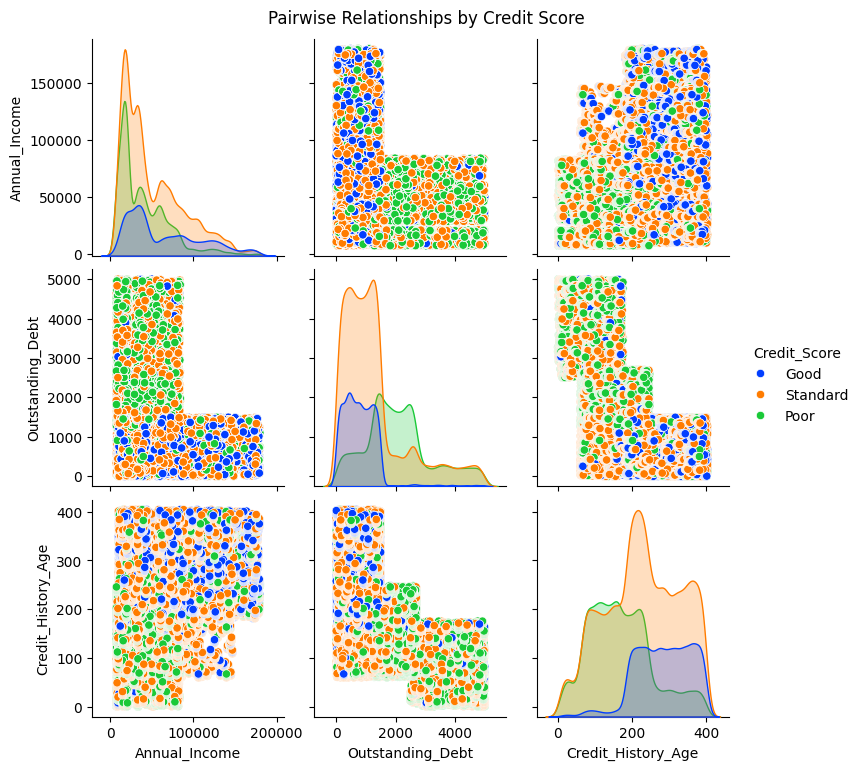

In [58]:
# Pair Plot visualization code
import seaborn as sns
import matplotlib.pyplot as plt

# 1. Important columns
selected_cols = ['Annual_Income', 'Outstanding_Debt', 'Credit_History_Age', 'Credit_Score']

# 2. Pairplot
sns.pairplot(df[selected_cols], hue='Credit_Score', diag_kind='kde', palette='bright')

# 3. Title & Display
plt.suptitle("Pairwise Relationships by Credit Score", y=1.02)
plt.show()


##### 1. Why did you pick the specific chart?

- Shows all variable relationships in a single view — replaces 6+ individual charts.

- hue='Credit_Score' overlays all three groups across every plot simultaneously
KDE on diagonal reveals distribution shape per group without extra histograms.

- Best chart for exploratory analysis — quickly identifies which variables actually separate credit score groups.

- Pointed directly to Outstanding Debt and Credit History Age as the strongest signals before any modelling.

##### 2. What is/are the insight(s) found from the chart?

1) Annual Income & Credit Score (Top Left diagonal)
The KDE curve tells a clear story — Good score holders (blue) are heavily concentrated at lower income ranges too, meaning a high income alone does not guarantee a good credit score. All three groups overlap significantly, so income is helpful but not the deciding factor.

2) Outstanding Debt & Credit Score (Middle diagonal) This is the most telling chart. Poor score holders (green) are spread across all debt levels, but Good score holders (blue) tend to cluster at lower outstanding debt. The message is simple — people who keep their debt under control consistently maintain better credit scores.
- Debt level is a primary driver of credit deterioration.

3) Credit History Age & Credit Score (Bottom Right diagonal) Good scorers (blue) and Standard scorers (orange) show a broader and more spread out history age distribution, while Poor scorers (green) tend to have a shorter credit history. Longer credit history clearly associates with better scores — time and consistency matter.

4) Annual Income vs Outstanding Debt (Row 2, Col 1) Many low-income individuals have high debt. --> This combination is a strong indicator of Poor Credit Score.

- Good score customers mostly show --> Moderate/high income --> Low debt -->

- The scatter shows all three credit score groups are mixed across income and debt combinations — meaning you can have high income and still carry high debt, which hurts your score regardless of what you earn.

5) Credit History Age vs Outstanding Debt (Row 3, Col 2) People with longer credit history tend to have more controlled and lower outstanding debt. This suggests that financial maturity comes with time — experienced credit users borrow more responsibly.

## **5. Solution to Business Objective**

#### What do you suggest the client to achieve Business Objective ?
Explain Briefly.

 1) Target the Right Customers

- Use Credit Score segmentation to offer premium products to Good scorers and design special recovery plans for Poor scorers instead of rejecting them outright. Every Poor scorer is a future Good scorer waiting for the right guidance.

 2) Flag the Danger Zone Early

- Customers showing Low Income + High Outstanding Debt should be flagged immediately as high risk. Do not wait for them to default — intervene early with debt consolidation offers or lower EMI plans.

 3) Reward Good Behavior

- Customers with long Credit History and low debt should be fast tracked for better loan offers and lower interest rates. Rewarding responsible behavior encourages more of it.

 4) Tackle Late Payments Proactively

- Since late payments directly spike Interest Rates and damage scores, PaisaBazaar should send early reminders, offer auto-pay options, and create small incentives for on-time payments.

 5) Control Unnecessary Inquiries

- Too many loan inquiries hurt the customer's own score. PaisaBazaar should educate users about this and recommend only the most suitable product in one go rather than letting them apply to multiple lenders blindly.


# **Conclusion**

This project set out to understand what makes a customer financially risky or reliable — and the data answered that question very clearly.
Through Univariate, Bivariate, and Multivariate analysis, one story kept repeating itself. Financial health is not an accident. It is a pattern of habits built over time.


We found that income alone does not determine your Credit Score. People with decent earnings were still falling into Poor score territory because of unchecked debt, repeated late payments, and too many loan inquiries. On the other hand, customers with modest incomes but disciplined borrowing habits consistently showed Good scores.


The three biggest villains were clear — high outstanding debt, late payment cycles, and excessive credit inquiries. And the three biggest protectors were equally clear — controlled debt, long credit history, and stable income to debt ratio.


For PaisaBazaar, this analysis is more than just numbers. It is a roadmap. It tells them which customers need intervention, which ones deserve rewards, and which combinations of financial behavior should raise an immediate red flag.


The biggest takeaway from this entire project is simple — risk is not random. It is predictable. And if it is predictable, it can be prevented. That is exactly what smart data analysis like this exists to do.


### ***Hurrah! You have successfully completed your EDA Capstone Project !!!***